Setup:

In [30]:
# speaker diarization
from resemblyzer import preprocess_wav, VoiceEncoder # extract_embeddings
from resemblyzer.audio import sampling_rate # constant
from spectralcluster import SpectralClusterer # clustering
import speech_recognition as sr # speech-to-text
import wavio # save wav file

# visualization
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# other lib
from pathlib import Path
from IPython.display import Audio, display # display Audio in Jupyter Notebook
from pydub import AudioSegment # convert mp3 to wav
import numpy as np
import os

# create output folder
OUTPUT_FOLDER_NAME = 'output'
if not os.path.exists(OUTPUT_FOLDER_NAME):
    os.makedirs(OUTPUT_FOLDER_NAME)

Modular functions:

In [31]:
def mp3_to_wav(audio_file_path):
    """
    Convert mp3 to wav file
    """
    sound = AudioSegment.from_mp3(audio_file_path)
    audio_file_path = audio_file_path.split('.')[0] + '.wav'
    sound.export(audio_file_path, format="wav")
    return audio_file_path

def extract_embeddings(wav_file_path):
    """
    Extract embeddings given a wav file
    """
    # speech detection
    wav = preprocess_wav(wav_file_path)
    
    # save prepocessed wav
    fname = f"{wav_file_path.stem}_preprocessed.wav"
    wavio.write(os.path.join(OUTPUT_FOLDER_NAME, fname), wav, sampling_rate, sampwidth=4)

    # speech segmentation & embedding extracting
    encoder = VoiceEncoder("cpu")
    _, cont_embeds, wav_splits = encoder.embed_utterance(wav, return_partials=True, rate=20)

    return wav, cont_embeds, wav_splits, fname

def create_labelling(cont_embeds, wav_splits):
    """
    Create a dictionary contains interval labelling for each speaker
    """
    # clustering
    clusterer = SpectralClusterer(
        min_clusters=2,
        max_clusters=100
    )
    labels = clusterer.predict(cont_embeds)

    # labelling
    times = [int((s.start + s.stop)/2) for s in wav_splits]
    labelling = []
    start_time = 0

    for i, time in enumerate(times):
        if i > 0 and labels[i] != labels[i-1]:
            temp = (str(labels[i-1]), start_time, time)
            labelling.append(temp)
            start_time = time
        if i == len(times)-1:
            temp = (str(labels[i]), start_time, wav_splits[-1].stop)
            labelling.append(temp)

    return labelling

def viz_diarization(labelling, sampling_rate, preprocessed_wav_file_name):
    """
    Play diarization animation along with the wav audio
    """

    # prepare data
    y, xmin, xmax = np.array(labelling, np.int32).T
    speaker_num = len(np.unique(y))
    xmin = xmin / sampling_rate
    xmax = xmax / sampling_rate
    color_list = plt.rcParams['axes.prop_cycle'].by_key()['color']

    # step function
    fig, ax = plt.subplots()
    ax.hlines(y, xmin, xmax, color=np.array(color_list)[y], linewidth=50, alpha=0.8)
    ax.set_ylim(-0.5, speaker_num-0.5)
    ax.set_xlabel("Time (sec)")
    ax.set_ylabel("Speaker Label")
    ax.set_xticks(np.arange(0, max(xmax), 5))
    ax.yaxis.get_major_locator().set_params(integer=True)

    # vertical line animation
    duration = xmax[-1] # in sec
    refreshPeriod = 100 # in ms

    vl = ax.axvline(0, ls='-', color='r', lw=1, zorder=10)
    def animate(i, vl, period):
        t = i*period / 1000
        vl.set_xdata(t)
        return vl,
    ani = FuncAnimation(fig,
                        animate,
                        repeat=False,
                        frames=int(duration/(refreshPeriod/1000)),
                        fargs=(vl, refreshPeriod),
                        interval=refreshPeriod,
                        blit=True)

    # play audio
    display(
        Audio(
            os.path.join(OUTPUT_FOLDER_NAME, preprocessed_wav_file_name),
            autoplay=True
        )
    )
    
    return ani

Main Functionality:

In [32]:
# define file to diarized
wav_file_path = Path('man_and_woman.wav')

# speaker diarization    
wav, cont_embeds, wav_splits, preprocessed_wav_file_name = extract_embeddings(wav_file_path)
labelling = create_labelling(cont_embeds, wav_splits)

Loaded the voice encoder model on cpu in 0.01 seconds.


<IPython.core.display.Javascript object>


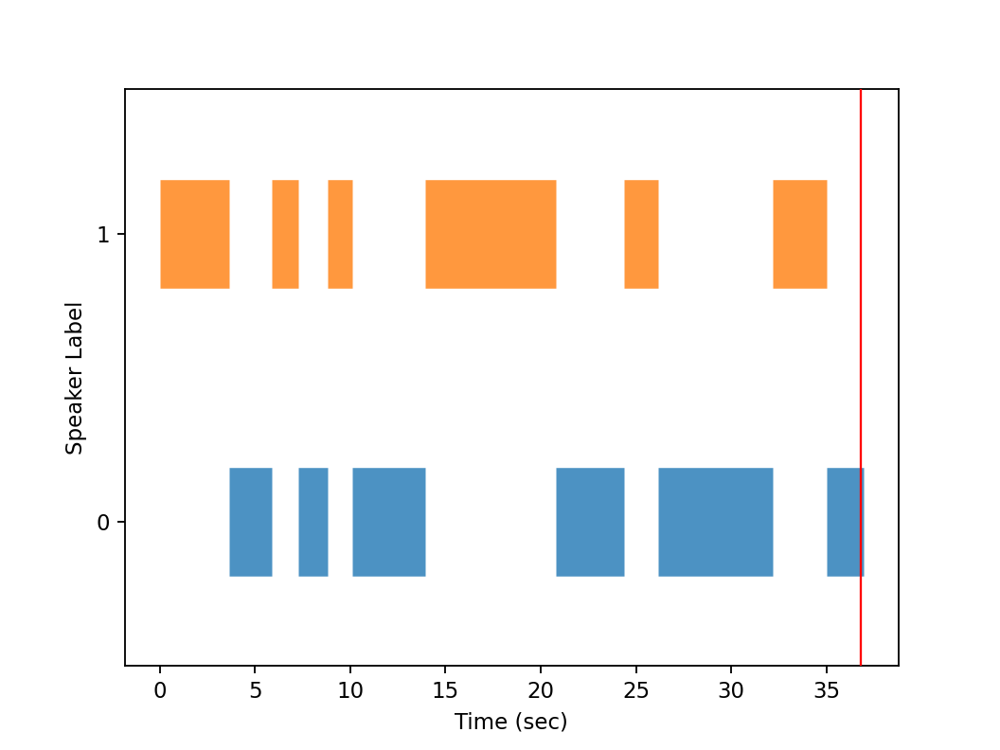

In [33]:
%matplotlib notebook
ani = viz_diarization(labelling, sampling_rate, preprocessed_wav_file_name)

To-do list:
- nentuin speech-to-text yang free tapi hasilnya transcriptnya bagus (perlu discuss)
- save wav files dan save txt files hasil transcript (DONE, tinggal jadiin function)
- create output as an application (API, streamlit app?)

---
dari sini ke bawah hanya untuk coret2an

# Libraries

In [1]:
# other lib
from pathlib import Path
from IPython.display import Audio # display Audio in Jupyter Notebook
from pydub import AudioSegment # convert mp3 to wav
import os
import numpy as np

# speaker diarization
from resemblyzer import preprocess_wav, VoiceEncoder # extract_embeddings
from resemblyzer.audio import sampling_rate # constant
from spectralcluster import SpectralClusterer # clustering
import speech_recognition as sr # speech-to-text
import wavio # save wav file

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Audio File

In [2]:
wav_file_path = Path('man_and_woman.wav')
Audio(wav_file_path)

# Convert `.mp3` to `.wav`

In [3]:
def mp3_to_wav(audio_file_path):
    sound = AudioSegment.from_mp3(audio_file_path)
    audio_file_path = audio_file_path.split('.')[0] + '.wav'
    sound.export(audio_file_path, format="wav")
    return audio_file_path

# mp3_to_wav('X2zqiX6yL3I.mp3')

# Speech Detection & Extract Embeddings

Speech detection: use Voice Activity Detector to remove noise and non-speech. Process behind it:
1. Load the wav
2. Resample the wav, the sampling rate will be automatically detected
3. Preprocess: normalize volume (ada rumusnya)
4. Preprocess: trim long silences
    - ada parameter defaultnya di: https://github.com/resemble-ai/Resemblyzer/blob/199c632495cfd288ca63b790e789616c91d44a01/resemblyzer/hparams.py

In [5]:
# create output folder
output_folder_name = 'output'
if not os.path.exists(output_folder_name):
    os.makedirs(output_folder_name)
    
for subfolder in ['segment', 'speaker']:
    path = os.path.join(output_folder_name, subfolder)
    if not os.path.exists(path):
        os.makedirs(path)

In [6]:
def extract_embeddings(wav_file_path):
    # speech detection
    wav = preprocess_wav(wav_file_path)
    # save prepocessed wav
    fname = f"{wav_file_path.stem}_preprocessed.wav"
    wavio.write(os.path.join(output_folder_name, fname), wav, sampling_rate, sampwidth=4)
    # write(os.path.join(output_folder_name, fname), sampling_rate, wav)

    # speech segmentation & embedding extracting
    encoder = VoiceEncoder("cpu")
    _, cont_embeds, wav_splits = encoder.embed_utterance(wav, return_partials=True, rate=20)

    return wav, cont_embeds, wav_splits

In [7]:
wav, cont_embeds, wav_splits = extract_embeddings(wav_file_path)
print(len(wav)) # length of preprocessed wav
print(cont_embeds.shape) # (segments_num, embedding_dim)
print(len(wav_splits)) # (segments_num)

Loaded the voice encoder model on cpu in 0.01 seconds.
590400
(708, 256)
708


> Note: kalo pake parameter `rate` audionya jadi lebih panjang sedikit, karena ada padding

In [8]:
# ini hanya ngecek len(wav) tuh maksudnya apa
audio = AudioSegment.from_file("output/man_and_woman_preprocessed.wav")
audio.duration_seconds * sampling_rate

590400.0

# Labelling

- Spectral Cluster

In [9]:
def create_labelling(cont_embeds, wav_splits):
    # clustering
    clusterer = SpectralClusterer(
        min_clusters=2,
        max_clusters=100
    )
    labels = clusterer.predict(cont_embeds)

    # labelling
    times = [int((s.start + s.stop)/2) for s in wav_splits]
    labelling = []
    start_time = 0

    for i, time in enumerate(times):
        if i > 0 and labels[i] != labels[i-1]:
            temp = (str(labels[i-1]), start_time, time)
            labelling.append(temp)
            start_time = time
        if i == len(times)-1:
            temp = (str(labels[i]), start_time, wav_splits[-1].stop)
            labelling.append(temp)

    return labelling
  
labelling = create_labelling(cont_embeds, wav_splits)
labelling # (speaker_label, start_time, end_time)

[('1', 0, 58400),
 ('0', 58400, 93600),
 ('1', 93600, 116000),
 ('0', 116000, 140800),
 ('1', 140800, 161600),
 ('0', 161600, 223200),
 ('1', 223200, 332800),
 ('0', 332800, 390400),
 ('1', 390400, 418400),
 ('0', 418400, 515200),
 ('1', 515200, 560000),
 ('0', 560000, 591200)]

<IPython.core.display.Javascript object>


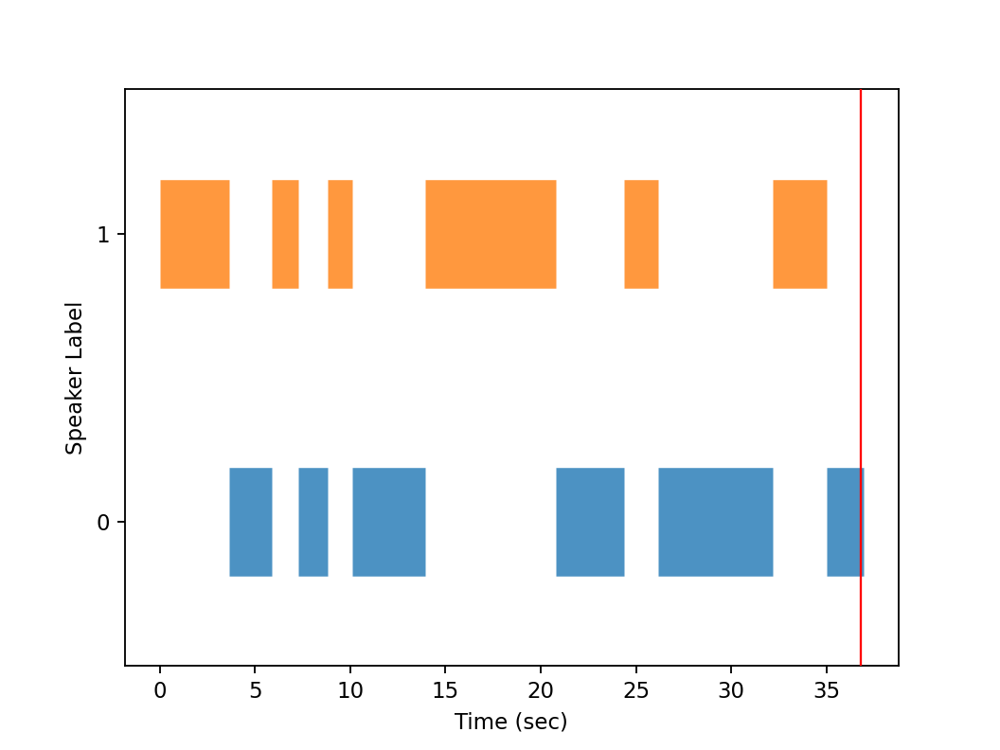

In [10]:
%matplotlib notebook

# prepare data
y, xmin, xmax = np.array(labelling, np.int32).T
speaker_num = len(np.unique(y))
xmin = xmin / sampling_rate
xmax = xmax / sampling_rate
color_list = plt.rcParams['axes.prop_cycle'].by_key()['color']

# step function
fig, ax = plt.subplots()
ax.hlines(y, xmin, xmax, color=np.array(color_list)[y], linewidth=50, alpha=0.8)
ax.set_ylim(-0.5, speaker_num-0.5)
ax.set_xlabel("Time (sec)")
ax.set_ylabel("Speaker Label")
ax.set_xticks(np.arange(0, max(xmax), 5))
ax.yaxis.get_major_locator().set_params(integer=True)

# vertical line animation
duration = xmax[-1] # in sec
refreshPeriod = 100 # in ms

vl = ax.axvline(0, ls='-', color='r', lw=1, zorder=10)
def animate(i, vl, period):
    t = i*period / 1000
    vl.set_xdata(t)
    return vl,
ani = FuncAnimation(fig,
                    animate,
                    repeat=False,
                    frames=int(duration/(refreshPeriod/1000)),
                    fargs=(vl, refreshPeriod),
                    interval=refreshPeriod)

# play audio
Audio("output/man_and_woman_preprocessed.wav", autoplay=True)

# Speech-to-Text

In [13]:
# GOOGLE CLOUD SPEECH2TEXT
import os
from google.cloud import speech
import tempfile

os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = 'client_service_key.json'
speech_client = speech.SpeechClient()

def wav_array_to_text_cloud(array):
    DEFAULT = ("<TRANSCRIPT_ERROR>", 0)
    
    # save temporary file
    fd, path = tempfile.mkstemp(suffix=".wav")
    
    try:
        wavio.write(path, array, sampling_rate, sampwidth=2)
    except ValueError:
        return DEFAULT

    # Step 1. Load the media files
    with open(path, 'rb') as f:
        byte = f.read()
        audio = speech.RecognitionAudio(content=byte)

    # Step 2. Configure Media Files Output
    config = speech.RecognitionConfig(
        sample_rate_hertz=sampling_rate,
        enable_automatic_punctuation=True,
        language_code='en-US'
    )

    # Step 3. Transcribing the RecognitionAudio objects
    response = speech_client.recognize(config=config, audio=audio)
    results = response.results
    if len(results) != 0:
        transcript = response.results[0].alternatives[0].transcript
        confidence = response.results[0].alternatives[0].confidence
    else:
        return DEFAULT

    # close and remove temporary file
    os.close(fd)
    os.remove(path)

    return transcript, confidence

In [19]:
transcripts = []
for label, start_time, end_time in labelling:
    cut = wav[start_time:end_time]
    text, conf = wav_array_to_text_cloud(cut)
    transcripts.append(f"Speaker {label}: {text} ({conf})")

In [22]:
print('\n'.join(transcripts))

Speaker 1: New tax Solutions. David speaking. How can I help you? (0.922355055809021)
Speaker 0: Hi, may I speak to John Carter? (0.9313846230506897)
Speaker 1: Who's calling, please? (0.9430074691772461)
Speaker 0: This is Mary Silva. (0.9748963713645935)
Speaker 1: How do you spell your last name? (0.9113006591796875)
Speaker 0: Silver silver. (0.8560483455657959)
Speaker 1: One moment, please. I'm Sorry Miss. Silver. Mister car is in a meeting now. Can I take a message? (0.9313789010047913)
Speaker 0: Yes, could you ask him to call me back as soon as possible? (0.9865036010742188)
Speaker 1: Sure. Does he have a number? (0.8992307782173157)
Speaker 0: He has my home number. Let me give you my cell number. It's 604-9911. (0.8947964906692505)
Speaker 1: Okay, Miss Silva. I'll give him the message. (0.924749493598938)
Speaker 0: Thanks a lot. (0.9639435410499573)


In [23]:
with open("output/transcript_cloud.txt", "w") as f:
    f.write('\n'.join(transcripts))

Kelebihan Google Cloud punya:
+ model pretrainednya lebih accurate daripada Google biasa
+ ada nilai confidence

Kelemahannya:
- free trialnya cuman 60 menit request (900 detik), selebihnya bayar beberapa perak. https://cloud.google.com/speech-to-text/pricing
- 1x request API di-round up jadi kelipatan 15 detik, contoh:
    - Audio 1 sampai 15 detik diitung 15 detik
    - Audio 16 sampai 30 detik diitung 30 detik
    - dst...
- kalo potongan audionya >= 60 detik, maka perlu upload filenya ke bucket dulu baru bisa ditranscript

In [24]:
# GOOGLE SPEECH2TEXT
import speech_recognition as sr
import tempfile

def wav_array_to_text(array):
    # save temporary file
    fd, path = tempfile.mkstemp(suffix=".wav")
    
    try:
        wavio.write(path, array, sampling_rate, sampwidth=4)
    except ValueError:
        pass

    # speech-to-text
    r = sr.Recognizer()
    with sr.AudioFile(path) as source:
        r.adjust_for_ambient_noise(source)
        audio = r.record(source)
        try:
            text = r.recognize_google(audio)
        except:
            text = "<NOT_RECOGNIZED>"

    # close and remove temporary file
    os.close(fd)
    os.remove(path)
    
    return text

In [25]:
transcripts2 = []
for label, start_time, end_time in labelling:
    cut = wav[start_time:end_time]
    text = wav_array_to_text(cut)
    transcripts2.append(f"Speaker {label}: {text}")

In [26]:
print('\n'.join(transcripts2))

Speaker 1: Solutions David speaking how can I help you
Speaker 0: can I speak to John Carter
Speaker 1: please
Speaker 0: <NOT_RECOGNIZED>
Speaker 1: <NOT_RECOGNIZED>
Speaker 0: silver
Speaker 1: please I'm Sorry Miss silver Mister car is in a meeting now can I take a message
Speaker 0: you ask him to call me back as soon as possible
Speaker 1: <NOT_RECOGNIZED>
Speaker 0: phone number let me give you my cell number is 604
Speaker 1: silver I'll give him the message
Speaker 0: <NOT_RECOGNIZED>


In [27]:
with open("output/transcript_basic.txt", "w") as f:
    f.write('\n'.join(transcripts2))

# Save wav files

In [28]:
# save each segment audio to a file
for idx, (label, start_time, end_time) in enumerate(labelling):
    cut = wav[start_time:end_time]
    fname = f"part_{idx}.wav"
    try:
        wavio.write(os.path.join(output_folder_name, "segment", fname), cut, sampling_rate, sampwidth=4)
    except:
        pass

In [29]:
# save each speaker audio to a file
split_result = {}
for label, start_time, end_time in labelling:
    cut = wav[start_time:end_time]
    if label not in split_result:
        split_result[label] = cut
    else:
        split_result[label] = np.append(split_result[label], cut)

split_result
        
for label, wav in split_result.items():
    fname = f"speaker{label}.wav"
    wavio.write(os.path.join(output_folder_name, "speaker", fname), wav, sampling_rate, sampwidth=4)